# Tutorial

# Table of Contents
1. [The Polymer class](#intro)
2. [The Experiment class](#experimentclass)
    1. [A first example: One simulation of a Langevin dynamic](#ex1)
3. [More examples](#moreexamples)
    1. [Adding excluded volume forces](#ex2)
    2. [Adding local excluded volume forces](#ex3)    
    3. [Studying the mean radius of gyration](#ex4)
    4. [First Encounter Times](#ex5)
    5. [Encounter Simulations: Repair and misrepair probability](#ex6)

## Overview

![IntroductionFigure](model.png)

## Introduction: The `Polymer` class  <a name="intro"></a>

### Import the ChromatinPolymerModels modules

In [1]:
## To import the Polymer and Experiments modules from ../../modules :
import os, sys
sys.path.append(os.path.dirname(os.path.dirname(os.getcwd())))

from modules.Polymers import RCLPolymer
from modules.Experiment import Experiment
from modules.Forces import ExcludedVolume, LocalExcludedVolume

Some libraries are also required to perform the experiments and deal with the results:

In [2]:
import numpy as np

### Building a polymer
The `RCLPolymer` class is a subclass of the more general `Polymer` class and allows us to create a **Random Cross-Linked Polymer** with its dimension (2 or 3), the number of monomers, the standard deviation of the bonds and the number of random cross-links as parameters.

For example, we can build a 3-dimensional polymer `p0` with $N = 100$ monomers, $b = 0.2 \ \mu m$ of bonds standard deviation and $ N_c = 5 $ random connectors.

In [3]:
p0 = RCLPolymer(numMonomers = 100, dim = 3, b = 0.2, Nc = 5)

We can visualize the polymer with the `matplotlib` library:

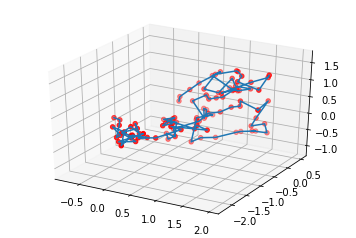

In [4]:
p0.plot()

### Simulating Langevin dynamics for the RCL polymer

We supposed the RCL polymer subdued to Langevin dynamics. So, if $(R_t)_{t\geq0} = (R_1, ..., R_N)_{t\geq0}$ are the monomer positions of the polymer in time, we have:

$$ dR_t = -\frac{1}{\zeta} \nabla \phi(R_t) dt + \sqrt{2D} dW_t $$

where $\zeta$ is the friction coefficient, $\phi$ is an harmonic potential, $D$ is the diffusion coefficient and $W_t$ is a $N \times 3$-dimensional Brownian motion.

We can simulate the motion of our polymer calling the `step` method of the class `Polymer`. `step` implements the Euler's scheme of the previous equation. We have to explicit the number of steps, the time-step $\Delta t$ we want to use and the diffusion coefficient $D$.

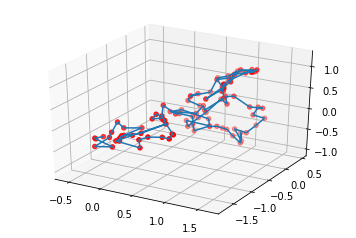

In [5]:
p0.step(numsteps=500,dt=0.01,D=0.008)
p0.plot()

### Simulating random double-strand breaks (DSBs)

The main idea of the project is to analyze the repair after multiple double-strand breaks (DSBs) in a chromatin polymer. 
A DSB implies the rupture of a bond between a pair of neighbor monomers. Only valid DSBs are allowed, i.e., where the polymer rests fully connected after the breaks (which is possible thanks to the random connectors). 

We simulate $N_b$ multiple random breaks separated by a deterministic distance (the interbreak distance) $g$ in monomers.
First we need to determine the cuts we'll induce to polymer (to be sure that they will be valid afterwards). The method `randomCuts` give us the breaks positons:

In [6]:
breakLoci = p0.randomCuts(g = 10, Nb = 2)
print('We are going to cut the bond just after the monomers %s and %s' % tuple(breakLoci))

We are going to cut the bond just after the monomers 74 and 85


We should verify that the cut is valid:

In [7]:
p0.isSplittable(breakLoci)

True

If it's not, we induce new random connectors until the polymer is finally able to be broken by the random DSBs. `Polymer.reset()` allows to reset the random connectors, keeping all the other parameters of the polymer unchanged, and keeping also its current position.

In [8]:
while(not(p0.isSplittable(breakLoci))):
    p0.reset()

Finally, once we have a valid combination of random connectors and random breaks, we can induce the DSBs. The method `Polymer.cutNow()` allows us to do that. 
Here, for example, we would like to simulate the dynamics of the polymer for some relaxation time before inducing the cuts. The polymer knows the relaxation time it needs (callable with `Polymer.relaxTime(`$D$ `)`, where $D$ is the diffusion constant). 

In [9]:
# Simulate until relaxation
dt_relax = 0.01 # time-step we want to the simulation until relaxation
D = 0.008 # duffusion constant
relaxSteps = np.ceil(p0.relaxTime(D)/dt_relax).astype(int)  # number of steps of the Euler scheme
p0.step(relaxSteps,dt_relax,D) # simulation until relaxation

# Induce the DSBs
p0.cutNow(breakLoci,definitive=True) # induction of breaks


## The `Experiment` class <a name="experimentclass"></a>

To obtains statistics, simulations as the two we have presented so far need to be performed in a series of Monte-Carlo simulations. For that purpose, the simple Langevin dynamics, the random cutting, and other useful simulations are implemented in the `Experiment` class.

To be initialised, all experiments need: a Results dictionary (that could be empty), a Parameters dictionary (with the parameteres required by the simulation), and a `Polymer` object.

Here we present some examples:

### A first example: One simulation of a Langevin dynamic <a name="ex1"></a>

We can simulate a number of steps of the polymer motion calling the experiment **SimpleDynamicSimulation**.

**SimpleDynamicSimulation** moves the polymer until relaxation time, and then saves the trajectory it follows for a number `numSteps` of steps.

In [10]:
polymerParams = dict(numMonomers = 100,
                     dim         = 3,
                     b           = 0.2,
                     Nc          = 5
                     )

simulationParams = dict(# Physical parameters
                        diffusionConstant = 0.008,
                        # Numerical parameters
                        numRealisations   = 1, 
                        dt                = 0.01,
                        dt_relax          = 0.01,
                        numSteps          = 200
                        )

p0 = RCLPolymer(**polymerParams)
results = {}
mc = Experiment(p0, results, simulationParams)

Simulation of a Simple Dynamic (no breaks)


Finally, we can plot the trajectory of the polymer:

In [11]:
%matplotlib inline
from IPython.display import HTML
from matplotlib import rc
rc('animation', html='jshtml')

mc.plot_trajectoire()

To explore the results, call `Experiment.results`:

In [12]:
mc.results.keys()

dict_keys(['iterationsNumber', 'lastTrajectory', 'MSRG'])

For instance, if we are interest at the mean square radius of gyration at relaxation time:

In [13]:
print('The mean square radius of gyration at relaxation time is %s micron**2' % mc.results['MSRG'])

The mean square radius of gyration at relaxation time is 0.557823082387849 micron**2


## Other examples <a name="otherexamples"></a>

### Adding excluded volume forces <a name="ex2"></a>

The module `Forces` contains forces that can be added to the simulation. For instance, let's consider the simulation of excluded volume forces. 

Nothing forbids the monomers to overlap. Exclusion forces induces a repulsion field between the monomers, so the polymer acquires a self-avoiding behaviour.  Here we use a harmonic form of the exclusion potential :

$$ \phi_{EV}(R) = - \frac{\kappa}{2} \sum_{i,j : i \neq j} ||R_i - R_j||^2 1_{(||R_i - R_j|| < \sigma )} $$

where $\sigma$ is a cutoff radius and $\kappa$ the spring constant. 

The `ExcludedVolume` function of the `Forces` module implements the potential gradient $ \nabla \phi_{EV}(R) $ as a function with a `Polymer` object and the cutoff distance $\sigma$ as arguments.  The method `Polymer.addnewForce(...)` adds new forces to the harmonic potential in the Langevin equation. The added force must be a callable which only argument is a `Polymer` object.

In [14]:
# 1. Create the polymer
p0 = RCLPolymer(**polymerParams)

# 2. Define the repulsion potential gradient. IT MUST DEPEND ON THE POLYMER ONLY    
excludedVolumeCutOff = 2*p0.b
kappa                = 3*0.008/(p0.b**2)

repulsionForce = lambda polymer : -kappa * ExcludedVolume(polymer, excludedVolumeCutOff)

# 3. Add the repulsion potential
p0.addnewForce(repulsionForce)

# 4. Simulate the dynamic
results = {}
mc = Experiment(p0, results, simulationParams)

# 5. Visualize the polymer
mc.plot_trajectoire()

Simulation of a Simple Dynamic (no breaks)


In [24]:
# 6. Get the mean square radius of gyration
print('The mean square radius of gyration at relaxation time is %s micron**2' % mc.results['MSRG'])

The mean square radius of gyration at relaxation time is 1.8231040507505174 micron**2


### Adding local excluded volume forces <a name="ex3"></a>

We would like to induce exclusion force in only some of the monomers. For instance, we could exclude only the monomers in wich DSBs have been induced, to simulate the exclusion induced by the DNA repair machinery.

The function `localExcludedVolume` in the `Forces` module implements the harmonic exclusion potential only in the indicated monomers.

In [33]:
p0 = RCLPolymer(**polymerParams)
    
kappa = 3*D/(p0.b**2)
    
monomers2Exclude = [5,6,10,11,70,71]  # Suppose that there are going to be DSBs between the pairs 5-6, 10-11 and 70-71

repulsionForce = lambda polymer : - kappa * LocalExcludedVolume(polymer, monomers2Exclude, excludedVolumeCutOff)
    
p0.addnewForce(repulsionForce)

mc = Experiment(p0, results, simulationParams)

print('MRG with local volume exclusion : %s $\mu$ m' % np.sqrt(mc.results['MSRG']))

# For the plotting :
mc.polymer.colors = ['g']*p0.numMonomers # all monomers in green 

for monomer in monomers2Exclude: mc.polymer.colors[monomer] = 'r'  # but the excluded monomers in red

mc.plot_trajectoire()

Simulation of a Simple Dynamic (no breaks)
MRG with local volume exclusion : 0.8053407190368164 $\mu$ m


### Studying statistical properties <a name="ex2"></a>

If we perform a series of simulations we can obtain the mean of different statistical properties. For example, we could want to compare the mean radius of gyration for polymers with different number of cross-links:

In [17]:
results = {}


## RCL Polymer with two domains

For a 200 monomers polymer, we define two domains: one between 20 and 70 and the other one between 110 and 160, with 5 random connectors each.

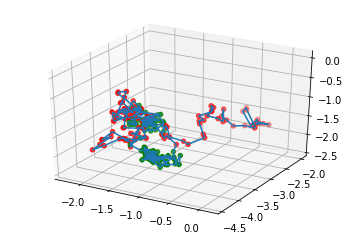

In [18]:
p0 = RCLPolymer(200, 3, 0.2, 0)

p0.domainConnect(20,70,6)
p0.domainConnect(110,160,6)

# Simulate until relaxation
dt_relax = 0.01 # time-step we want to the simulation until relaxation
D = 0.008 # duffusion constant
relaxSteps = np.ceil(p0.relaxTime(D)/dt_relax).astype(int)  # number of steps of the Euler scheme
# WARNING : This relaxation time is not quite correct (#TODO)
p0.step(relaxSteps,dt_relax,D) # simulation until relaxation

p0.colors = ['r']*200
p0.colors[20:70] = ['g']*(70-20)
p0.colors[110:160] = ['g']*(160-110)
p0.plot()

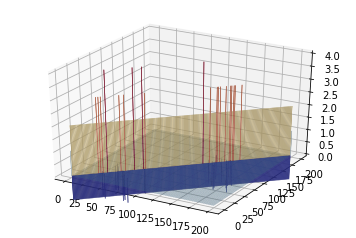

In [19]:
p0 = RCLPolymer(200, 3, 0.2, 0)

p0.domainConnect(20,70,6)
p0.domainConnect(110,160,6)

p0.showMatrix()

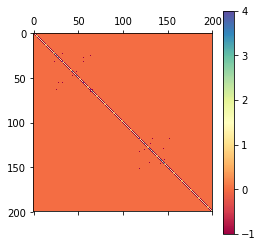

In [20]:
import matplotlib.pyplot as plt

laplacian = plt.matshow(p0.LaplacianMatrix, cmap='Spectral')
plt.colorbar(laplacian);

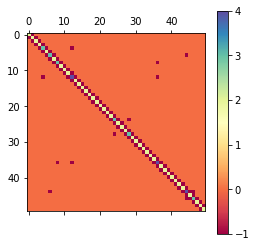

In [21]:
laplacian = plt.matshow(p0.LaplacianMatrix[20:70][:,20:70], cmap='Spectral')
plt.colorbar(laplacian);